## Retail data Analysis & Customer Segmentation

## Introduction
Business Intelligence is one  of the key drivers of morden Business Strategy. Big corporations have invested a lot to take advantage of this; Clear access to 'what happened, how, why and what might happen', which have come to be known as Exploratory, Predictive and diagnostic/prescriptive data analytics. 

This Notebook is about Customer segmentation & tageting and how they directly affect the 'fact matric' which is Sales. The notebook focuses on the technical bits as it will be accompanied by a presentation. Also information learned here is then packaged into insightful reports and dashboards for corporate apeal.

## What to expect in this notebook:

*  Exploratory data analysis: which will have visual interpretation and will trying to understand purchase behaviour of customers by time delta and geography. Also backed with statistical hypothesis testing.
* Customer segmentation on LRFM data analysis.
* Weekly/Daily Time series Forecasting.
* Sales prediction of new customer or estimates new sales of existing customers by Log-Log models to completement Customer Targeting.

In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from math import ceil

from sklearn.cluster import KMeans
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.manifold import TSNE
import plotly
import plotly.io as pio
pio.renderers.default = "colab"
plotly.offline.init_notebook_mode(connected=True)

from ipywidgets import interact, interactive, fixed, interact_manual,VBox,HBox,Layout
import ipywidgets as widgets

## Get Data
The dataset is based on a transnational data set which contains all the transactions occurring between 01/12/2010 and 09/12/2011 for a UK-based and registered non-store online retail. The company mainly sells unique all-occasion gifts. The Data can be accessed here @ [UCI Machine Learning Repository](https://archive.ics.uci.edu/ml/datasets/online+retail)

In [2]:
data= pd.read_csv('data\Online-Retail.csv',header=0,encoding="ISO-8859-1",engine='c')
print('Number of rows={0:.0f} and columns={1:.0f} \n'.format(data.shape[0],data.shape[1]))
print(data.info())

Number of rows=541909 and columns=8 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   StockCode    541909 non-null  object 
 2   Description  540455 non-null  object 
 3   Quantity     541909 non-null  int64  
 4   InvoiceDate  541909 non-null  object 
 5   UnitPrice    541909 non-null  float64
 6   CustomerID   406829 non-null  float64
 7   Country      541909 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 33.1+ MB
None


In [3]:
data.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 8:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 8:26,3.39,17850.0,United Kingdom


## Data Preprocessing 

Below we explicitly declare data types to pandas since we are going to be dealing with temporal data  and create other features in time dimension.

In [4]:
data['InvoiceDate']=pd.to_datetime(data['InvoiceDate'])
data['Sales'] = data.Quantity*data.UnitPrice
data['Year']=data.InvoiceDate.dt.year
data['Month']=data.InvoiceDate.dt.month
data['Week']=data.InvoiceDate.dt.isocalendar().week
data['Year_Month']=data.InvoiceDate.dt.to_period('M')
data['Hour']=data.InvoiceDate.dt.hour
data['Day']=data.InvoiceDate.dt.day
data['is_cancelled']=data.InvoiceNo.apply(lambda x: 'Yes' if x[0]=='C' else 'No')
data['weekday'] = data.InvoiceDate.dt.day_name()
data['Quarter'] = data.Month.apply(lambda m:'Q'+str(ceil(m/4)))
data['Date']=pd.to_datetime(data[['Year','Month','Day']])
data.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Sales,Year,Month,Week,Year_Month,Hour,Day,is_cancelled,weekday,Quarter,Date
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,15.30,2010,12,48,2010-12,8,1,No,Wednesday,Q3,2010-12-01
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,2010,12,48,2010-12,8,1,No,Wednesday,Q3,2010-12-01
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,22.00,2010,12,48,2010-12,8,1,No,Wednesday,Q3,2010-12-01
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,2010,12,48,2010-12,8,1,No,Wednesday,Q3,2010-12-01
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34,2010,12,48,2010-12,8,1,No,Wednesday,Q3,2010-12-01


From the info below, Some of customer ID and discription is missing. This shows that almost 20% of transactions are not mapped to any customer which can be a bigger issue while identifying potential customers


In [5]:
#Removing missing data.

missing_data = data.isnull().sum().reset_index()
missing_data.columns=['Variables','missing_count']
missing_data['missing_perc']=missing_data.missing_count/data.shape[0]
print(missing_data)
del missing_data

       Variables  missing_count  missing_perc
0      InvoiceNo              0      0.000000
1      StockCode              0      0.000000
2    Description           1454      0.002683
3       Quantity              0      0.000000
4    InvoiceDate              0      0.000000
5      UnitPrice              0      0.000000
6     CustomerID         135080      0.249267
7        Country              0      0.000000
8          Sales              0      0.000000
9           Year              0      0.000000
10         Month              0      0.000000
11          Week              0      0.000000
12    Year_Month              0      0.000000
13          Hour              0      0.000000
14           Day              0      0.000000
15  is_cancelled              0      0.000000
16       weekday              0      0.000000
17       Quarter              0      0.000000
18          Date              0      0.000000


There are negative numbers under quantity hence sales are also negative. Negative number can be return transactions. Ideally, we should align each return with respective sales transaction and cancel out the entry. But for the purpose of this analysis we will remove negative quantity.

In [6]:
fig = make_subplots(rows=1, cols=3)

fig.add_trace(go.Box(y=data.UnitPrice),row=1, col=1)
fig.add_trace(go.Box(y=data.Quantity),row=1, col=2)
fig.add_trace(go.Box(y=data.Sales),row=1, col=3)

fig.update_xaxes(title_text="Unit Price", row=1, col=1)
fig.update_xaxes(title_text="Quantity", row=1, col=2)
fig.update_xaxes(title_text="Sales", row=1, col=3)

fig.update_layout(height=500, width=700)
fig.show()

From the plot:
* United Kingdom has highest sales and it alone contributes 84% of total sales
* United Kingdom, Netherlands, EIRE (Republic of Ireland) , Germany, France, Australia, Spain are 7 countries which as 95% of total sales
* Netherlands has highest average sales per transaction compare to other countries
* United Kingdom has performed consistently each quarter followed by Netherlands whereas Germany which was on 6th Rank in Q1 2011 achieved 3rd rank in Q4 2011


In [7]:
df = px.data.gapminder()
df = df [['country','iso_alpha']]
data = pd.merge(data,df[['country','iso_alpha']],left_on='Country',right_on='country',how='left').drop(columns=['country'])
del df

In [8]:
grp_data = data.groupby(by='Country')['Sales'].sum().sort_values(ascending=False).reset_index()

fig = go.Figure(data=go.Choropleth(
    locations = grp_data['Country'],
    z = grp_data['Sales'],
    text = grp_data['Country'],
    colorscale = 'earth',
    locationmode = 'country names',
    autocolorscale=False,
    reversescale=False,
    marker_line_color='darkgray',
    marker_line_width=0.5,
    colorbar_title = 'Sales',
))


fig.update_layout(
    title_text='Sales by country',
    geo=dict(showframe=False,showcoastlines=False,projection_type='equirectangular'),
    annotations = [dict(x=0.55,y=0.1,xref='paper',yref='paper',showarrow = False)])

fig.show()

del grp_data

In [9]:
# delete negative quantity
data_=data[data.is_cancelled=='No']
del data

Quarterly ranking change of each country with respect sales.


In [10]:
#Group sales by quarter per country
quarter_sales_country = data_.pivot_table(index='Country', columns='Quarter', values='Sales',aggfunc='sum').fillna(0)
rank_data = quarter_sales_country.apply(lambda x: x.rank(method='dense').astype(int)).reset_index()
rank_data['idx']=rank_data.index
rank_data = rank_data.melt(id_vars=['Country','idx'])

fig = px.scatter(rank_data , y="Country", x='Quarter', color="Country", hover_data=['Country']
                 ,size='value')

fig.update_layout(height=1500,width=700)
fig.show()

del [rank_data,quarter_sales_country]

There are some spikes from the data of which if provided context they could be from events like promotions, however they will be considered here as random events.

In [11]:
sales_by_date = data_.groupby(by='Date')['Sales'].sum().reset_index()
fig = go.Figure(data=go.Scatter(x=sales_by_date.Date,y=sales_by_date.Sales
                                ,line = dict(color='black', width=1.5)))
fig.update_layout(xaxis_title="Date",yaxis_title="Sales",title='Daily Sales',template='ggplot2')
fig.show()

**Insights drawn:**
* Hourly sales are normally distributed and with mean 709k. 
* There is no pattern in day wise sales in a month.
* There is no business on Saturday.
* Average sales are consistent from Monday to Friday
* Sales starts at 6 in the morning and ends at 8 PM. 
* Peak hours of sales are between 10 AM to 3 PM
* Monday and Tuesday Sales starts at 7 AM and close at 6 PM
* Wednesday and Friday sales start at 7 AM and close at 8 PM
* Business hours for Sunday is between 9 to 4 PM



In [12]:
sales_by_hour = data_.groupby(by='Hour')['Sales'].sum().reset_index()
sales_by_weekday = data_.groupby(by='weekday')['Sales'].sum().reset_index()

fig = make_subplots(rows=1, cols=2,subplot_titles=("Total Hourly Sales", "Total Sales by Weekday"))
fig.add_trace(go.Bar(y=sales_by_hour.Hour, x=sales_by_hour.Sales,orientation='h'),row=1, col=1)
fig.add_trace(go.Bar(x=sales_by_weekday.weekday, y=sales_by_weekday.Sales),row=1, col=2)
fig.update_layout(height=700, width=800,template='ggplot2')
fig.update_xaxes(title_text="Sales", row=1, col=1)
fig.update_xaxes(title_text="Weekday", row=1, col=2)
fig.update_yaxes(title_text="Hours", row=1, col=1)
fig.update_yaxes(title_text="Sales", row=1, col=2)
fig.show()


del [sales_by_hour,sales_by_weekday]

In [13]:
customer_by_month1 = data_.groupby('CustomerID')['Date'].min().reset_index()
customer_by_month1['days'] = pd.TimedeltaIndex(customer_by_month1.Date.dt.day,unit="D")
customer_by_month1['Month'] = customer_by_month1.Date- customer_by_month1.days+pd.DateOffset(days=1)
customer_by_month1['Quarter_acquisition'] = customer_by_month1['Month'].dt.quarter.apply(lambda x:'Q'+str(x))
customer_by_month1['Year_acquisition'] = customer_by_month1['Month'].dt.year
customer_by_month = data_.groupby(by = customer_by_month1.Month)['CustomerID'].size().reset_index()
customer_by_month.sort_values(by ='Month',ascending=True,inplace=True)
customer_by_month['cum_customer'] = np.cumsum(customer_by_month.CustomerID)
customer_by_month['Month_1'] = customer_by_month['Month'].dt.strftime('%b-%y')


Customer acquisition period analysis by month

C:\Users\akgabi\AppData\Local\Temp/ipykernel_30716/984018045.py:3: UserWarning:

color is redundantly defined by the 'color' keyword argument and the fmt string "bo-" (-> color='b'). The keyword argument will take precedence.



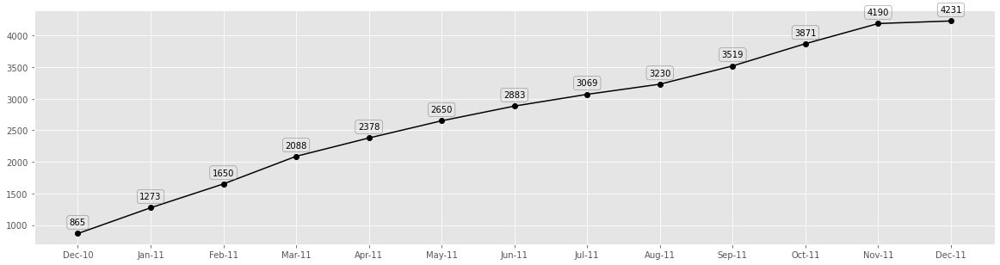

In [14]:
plt.style.use('ggplot')
plt.figure(figsize=(20,5))
plt.plot(customer_by_month.Month_1,customer_by_month.cum_customer,'bo-',color='black')

# zip joins x and y coordinates in pairs
for d,c in zip(customer_by_month['Month_1'],customer_by_month['cum_customer']):

    label = "{:.0f}".format(c)

    plt.annotate(label, 
                 (d,c), 
                 textcoords="offset points"
                 , bbox=dict(boxstyle="round", fc="none", ec="gray")
                 ,xytext=(0,10),
                 ha='center') 
plt.show()

del customer_by_month

Existing customers acquisition & their Sales contribution in future years/over time. 

Customer who made their first purchase in Q4 of Dec 2010 had large contribution in future quarter of 2011, same observation applies to the customers who were acquired in first quarter of 2011.

In [15]:
customer_sales = data_.groupby(by = ['CustomerID','Year','Quarter'])['Sales'].sum().reset_index()
customer_sales = customer_sales.merge(customer_by_month1[['CustomerID','Quarter_acquisition','Year_acquisition']]
                                      ,on ='CustomerID',how='inner')
customer_sales_acquisition = customer_sales.groupby(by=['Year','Quarter','Year_acquisition','Quarter_acquisition'])['Sales'].sum().reset_index()
customer_sales_acquisition['Sales_Year_quarter'] =customer_sales_acquisition[['Year','Quarter']].apply(lambda row:str(row.Year)+'-'+row.Quarter,axis=1)
customer_sales_acquisition['Acquisition_Year_quarter'] =customer_sales_acquisition[['Year_acquisition','Quarter_acquisition']].apply(lambda row:str(row.Year_acquisition)+'-'+row.Quarter_acquisition,axis=1)
customer_sales_acquisition.drop(columns =['Year','Quarter','Year_acquisition','Quarter_acquisition'],inplace=True)
df = customer_sales_acquisition.pivot(index='Sales_Year_quarter',columns =['Acquisition_Year_quarter']).fillna(0).reset_index()


fig = go.Figure(data=[
    go.Bar(name='First Order 2010-Q4', x=df.Sales_Year_quarter, y=df.iloc[:,1],marker_color='lightslategrey'),
    go.Bar(name='First Order 2011-Q1', x=df.Sales_Year_quarter, y=df.iloc[:,2],marker_color='lightblue'),
    go.Bar(name='First Order 2011-Q2', x=df.Sales_Year_quarter, y=df.iloc[:,3],marker_color='seagreen'),
    go.Bar(name='First Order 2011-Q3', x=df.Sales_Year_quarter, y=df.iloc[:,4],marker_color='orange')
])
fig.update_layout(barmode='stack',template='ggplot2')
fig.show()

del [customer_sales_acquisition, df,customer_sales]

# Frequecny (Rpeat Purchase)

* Most of customers made their next purchase after one or two months of first purchase
* There were 28 customers who made their first purchase in Dec 2010 also made their next purchase after 12 months
* 33 customers made their second purchase after 7 months of their first purchase in Mar 2011.

In [16]:
cust_date =data_.loc[~data_.CustomerID.isna(),['CustomerID','Date']].drop_duplicates()
cust_date.sort_values(by=['CustomerID','Date'],inplace=True)
cust_date['rnk'] = cust_date.groupby(by='CustomerID')['Date'].transform('rank', method='dense')
cust_date = cust_date[cust_date.rnk<=2]
cust_date['Purchase'] = cust_date.rnk.map({1:'First Purchase',2:'Second Purchase'})

cust_purchase= cust_date.pivot(index='CustomerID',columns=['Purchase'],values='Date').reset_index()

cust_purchase['gap']=(cust_purchase['Second Purchase']- cust_purchase['First Purchase'])/ np.timedelta64(30, 'D')
cust_purchase['gap'] = cust_purchase['gap'].fillna(0).apply(lambda x:ceil(x))

days = pd.TimedeltaIndex(cust_purchase['First Purchase'].dt.day,unit="D")

cust_purchase['First_Purchase_month']=cust_purchase['First Purchase']- days+pd.DateOffset(days=1)
cust_purchase_grid = cust_purchase.pivot_table(index=['First_Purchase_month'],columns =['gap'],values='CustomerID',aggfunc='count').fillna(0)
cust_purchase_grid = cust_purchase_grid.sort_index( ascending=False)

fig = go.Figure(data=go.Heatmap(z=cust_purchase_grid
                                ,y=cust_purchase_grid.index,
                   x=cust_purchase_grid.columns.tolist(),
                   hoverongaps = True,colorscale='balance'))
fig.update_xaxes(side="top",showticklabels = True,ticktext= cust_purchase_grid.columns.tolist())
fig.update_layout(height=600,width=800,xaxis_title="Future Month of next Purchase after making first purchase"
                  ,yaxis_title="Month of 1st Purchase",
           yaxis=dict(autorange='reversed',showticklabels = True)
                  ,autosize=False,template='ggplot2')

fig.show()

del [cust_date,cust_purchase,days,cust_purchase_grid]

Below charts shows average sales by hours varies whereas average sales between 7AM to 10 AM is higher compare to other hours of the day. In right hand side chart, we can see that average sales on Sunday and Monday is low compare to other weekdays.

To proceed with further analysis, I would like to run few statistical tests to make sure the difference in average sales by hour and weekday are statistically significant


In [17]:
sales_by_hour = data_.groupby(by='Hour')['Sales'].mean().reset_index()
sales_by_weekday = data_.groupby(by='weekday')['Sales'].mean().reset_index()

fig = make_subplots(rows=1, cols=2,subplot_titles=("Avg Hourly Sales", "Avg Sales by Weekday"))
fig.add_trace(go.Bar(y=sales_by_hour.Hour, x=sales_by_hour.Sales,orientation='h'),row=1, col=1)
fig.add_trace(go.Bar(x=sales_by_weekday.weekday, y=sales_by_weekday.Sales),row=1, col=2)
fig.update_layout(height=700, width=800,template='ggplot2')
fig.update_xaxes(title_text="Sales", row=1, col=1)
fig.update_xaxes(title_text="Weekday", row=1, col=2)
fig.update_yaxes(title_text="Hours", row=1, col=1)
fig.update_yaxes(title_text="Sales", row=1, col=2)
fig.show()

del [sales_by_hour,sales_by_weekday]

## **Hypothesis Tests** and **modeling**

**Hour**

--------------------------------------------------------------------------

H0: Sales is same across hours from 6 AM to 10 PM

Ha: Sales varies by hour of the day

the p value here is less than .05 (a confidence threshold point to take risk). Hence, we can reject null hypothesis and concluded that average sales vary by hour of the day


In [18]:
from statsmodels.formula.api import ols
import statsmodels.api as sm
model = ols('Sales ~ C(Hour)',data=data_).fit()
#ols.summary()
table = sm.stats.anova_lm(model, typ=2)
print(table)
del [table,model]

                sum_sq         df           F  PR(>F)
C(Hour)   1.654420e+08       14.0  158.833686     0.0
Residual  4.669338e+11  6275959.0         NaN     NaN


**Weekday**

--------------------------------------------------------------------------

H0: Average Sales is same each weekday

Ha: Average Sales is not same for few days or all weekdays

Here also shows that p values is less than .05 , hence we can reject null hypothesis and conclude that average sales is different among weekdays.

**Separate observed variance data ANOVA**

In [19]:
model = ols('Sales ~ C(weekday)',data=data_).fit()

table = sm.stats.anova_lm(model, typ=2)
print(table)

del [table,model]


                  sum_sq         df           F         PR(>F)
C(weekday)  5.541742e+07        5.0  148.935881  1.093853e-158
Residual    4.670439e+11  6275968.0         NaN            NaN


Given the data's hourly transactions, we can aggregate data at customer level and features:

* Length of Stay = How long customer has been associated with business
* Frequency = How many times customer has given order in duration given in the data
* Monitory = Sales amount generated by each customer



In [20]:
LRFM = data_.groupby('CustomerID').agg(Frequency=pd.NamedAgg(column="InvoiceNo", aggfunc="nunique")
                                        ,Monetary=pd.NamedAgg(column="Sales", aggfunc="sum")).reset_index()

length = data_.groupby('CustomerID')['Date'].max() - data_.groupby('CustomerID')['Date'].min()
length =  (length/np.timedelta64(1, 'D')).reset_index()
length.columns = ['CustomerID','Length_of_stay']
LRFM = LRFM.merge(length,on='CustomerID',how='inner')
del length

LRFM.head()

,CustomerID,Frequency,Monetary,Length_of_stay
0,12346.0,1,926203.20,0.0
1,12347.0,7,51720.00,365.0
2,12348.0,4,21566.88,283.0
3,12349.0,1,21090.60,0.0
4,12350.0,1,4012.80,0.0


# 3 D View of Sales vs Length of Stay vs Frequency

From the graph, there are pontential sets of customers giving a opportunity for clustering.


In [21]:
fig = go.Figure(data=[go.Scatter3d(x=LRFM.Monetary,y=LRFM.Length_of_stay,z=LRFM.Frequency,mode='markers'
                                   ,marker=dict(size=4,color='coral',colorscale='Viridis',opacity=0.8))])
fig.update_layout(margin=dict(l=1, r=2, b=1, t=1)
                  ,scene=dict(xaxis=dict(title='Sales')
                              ,yaxis=dict(title='Lenght of Stay')
                              ,zaxis=dict(title='Frequency')),width=800,height=500)
fig.show()

## RFM Clustering (Segmentation)

#### Objective of this analysis is to find pattern in the data which can group customers based on certain statistical rules. Variables which are being used are Recency, Monitory and length of stay. Below is the detailed explanation of these features


**RFM Pipeline:**

* Run iteration for number of clusters to select optimal clusters
* Get Error and Silhouette Distance and plot
* Select optimal number of cluster and create group
* Plot Silhouette values with respect to different sample size
* Create Profile of customers by group
* Create 3 D view of features divided by group
* Create bi variate scatter plot coloured by group
* Create two-dimensional view of points by t-SNE


In [22]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.manifold import TSNE

# Iteration for K-means clustering

In [23]:
X=LRFM.drop(columns = 'CustomerID')
error = []
silhouette = []
np.random.seed(12)
rng = range(2,20)
for i in rng:
    km = KMeans(n_clusters=i, init='random',n_init=20, max_iter=200,tol=.0001, random_state=12)
    km.fit(X)
    error.append(km.inertia_)
    lbls = km.fit_predict(X)
    silhouette.append(silhouette_score(X, lbls))

fig = make_subplots(rows=1, cols=2,subplot_titles=("Number of Cluster vs Error", "Number of Cluster vs Silhouette"))
fig.add_trace(go.Scatter(x=list(rng), y=error),row=1, col=1)
fig.add_trace(go.Scatter(x=list(rng), y=silhouette),row=1, col=2)
fig.update_layout(height=500, width=800,template='ggplot2')
fig.update_xaxes(title_text="Number of Clusters", row=1, col=1)
fig.update_xaxes(title_text="Number of Clusters", row=1, col=2)
fig.update_yaxes(title_text="Errors", row=1, col=1)
fig.update_yaxes(title_text="Silhouette Distance", row=1, col=2)
fig.show()

del [error,silhouette,rng,km,lbls,X]

# Create Clusters

Customer Profiling based on 10 clusters

*Statistical optimal cluster size.*

In [24]:
X=LRFM.drop(columns = 'CustomerID')
cluster_lbls = KMeans(n_clusters=10, random_state=12).fit_predict(X)
X['cluster'] = cluster_lbls
X['sample_silhouette_values'] = silhouette_samples(X, cluster_lbls)
X['txt']=X.cluster.apply(lambda x:'Cluster '+str(x))

# Silhouette vs Sample
This gives glimpse of Silhouette values with respect outlier present in the data.

In [25]:

fig = go.Figure(data=go.Scatter(x=X.Monetary,y=X.sample_silhouette_values
                                , mode='markers',marker_color=X.cluster,text = X.txt))

fig.update_layout(xaxis_title="Sales",yaxis_title="Silhouette"
                  ,title='Sample Size vs Silhoutte Values')

fig.show()


**Cluster  vs Sales**

Show the group vs average sales and number of customers belonging to the group. 
Customers from Cluster 1 and 5 can be considered on high priority and can be offered some promotions so that they can continue their association with business. Whereas customers from cluster 3, 7 and 9 can be treated as medium size customer. 

For medium size customers we can understand their purchase pattern and provide some promotions accordingly.

In the end we have list of customers from remaining clusters who can be taken as seriously and if we see their length of stay is better than medium size customers but their order size and order frequency is very low. So, we may understand their purchases pattern, type of product they select, and we can offer them some discounts or vouchers, or we can do some cross sales with them.


In [26]:
df = X.groupby('cluster').agg({'cluster':'size', 'Monetary':'mean','Frequency':'mean','Length_of_stay':'mean'}) \
       .rename(columns={'cluster':'Size','Monetary':'Avg Sales','Frequency':'Avg Recency','Length_of_stay':'Avg Lenght of Stay'}) \
       .reset_index().sort_values(by = 'Avg Sales')

cluster_map ={'Cluster 4':'lightskyblue','Cluster 0':'lightskyblue','Cluster 8':'lightskyblue'
              ,'Cluster 6':'lightskyblue','Cluster 2':'lightskyblue',
             'Cluster 3':'orange','Cluster 7':'orange','Cluster 9':'orange'
              ,'Cluster 1':'olive','Cluster 5':'olive'}

txt =['Size = {0:.0f}'.format(i) for i in df.Size]
df['cluster']=df.cluster.apply(lambda x:'Cluster '+str(x))
df['Group']=df.cluster.map(cluster_map)

fig = make_subplots(rows=1, cols=3,subplot_titles=("Avg Sales", "Avg Recency",'Avg Lenght of Stay'))

fig.add_trace(go.Bar(y=df.cluster, x=df['Avg Sales'],hovertext=txt
                        ,text=txt,textposition='auto',marker_color=df.Group,orientation='h'),row=1, col=1)
fig.add_trace(go.Bar(y=df.cluster, x=df['Avg Recency'],hovertext=txt
                        ,text=txt,textposition='auto',marker_color=df.Group,orientation='h'),row=1, col=2)
fig.add_trace(go.Bar(y=df.cluster, x=df['Avg Lenght of Stay'],hovertext=txt
                        ,text=txt,textposition='auto',marker_color=df.Group,orientation='h'),row=1, col=3)

fig.update_traces(marker_line_color='rgb(8,48,107)', marker_line_width=1.5, opacity=0.8)
fig.update_layout(title_text='Cluster Size',width = 800,height=600,template='ggplot2'
                  ,font=dict(family="Courier New, monospace",size=10,color="RebeccaPurple"))

fig.show()


# 3 D view of clusters

In [27]:
fig = go.Figure(data=[go.Scatter3d(x=X.Monetary,y=X.Length_of_stay,z=X.Frequency,mode='markers'
                                   ,marker=dict(size=4,color=X.cluster
                                                ,colorscale='Viridis',opacity=0.8))])

# tight layout
fig.update_layout(margin=dict(l=1, r=2, b=1, t=1)
                  ,scene=dict(xaxis=dict(title='Sales')
                              ,yaxis=dict(title='Lenght of Stay')
                              ,zaxis=dict(title='Recency')),width=700,height=500)
fig.show()

# Bivariate View of by Segment

In [28]:
fig = go.Figure(data=go.Scatter(x=X.Monetary,y=X.Length_of_stay
                                , mode='markers',marker_color=X.cluster,text=X.txt))
fig.update_layout(xaxis_title="Sales",yaxis_title="Length of Stay",title='Sales vs Length of Stay'
                  ,width=800,height=500)
fig.show()

In [29]:
fig = go.Figure(data=go.Scatter(x=X.Monetary,y=X.Frequency
                                , mode='markers',marker_color=X.cluster,text=X.txt))
fig.update_layout(xaxis_title="Sales",yaxis_title="Frequency",title='Sales vs Frequency'
                  ,width=800,height=500)
fig.show()

# t-distributed Stochastic Neighbor Embedding.
t-SNE is a method to visualize high dimensional data in two dimensions
if the value of perplexity (It is the value to select nearest neighbors which will generate different samples) is more than 30 then algorithm is able to separate the points clearly which is what we apply below.

In [30]:
prpxlt = [10,15,30,40]
fig = make_subplots(rows=2, cols=2,subplot_titles=['perplexity = %s'%i for i in prpxlt])

for i, prpxlt_ in enumerate(prpxlt):
    X_tsne = TSNE(n_components=2, init='random',
                         random_state=0, perplexity=prpxlt_).fit_transform(X[['Frequency', 'Monetary', 'Length_of_stay']])
    if i%2==0:
        c=2
    else:
        c=1
    r = (i)//2+1
    fig.add_trace(go.Scatter(x=X_tsne[:,0],y=X_tsne[:,1]
                                    , mode='markers',marker=dict(size=4,color=X.cluster
                                                ,colorscale='Viridis',opacity=0.8),text=X.txt),row=r, col=c)

    fig.update_xaxes(title_text="Component 1", row=r, col=c)
    fig.update_yaxes(title_text="Component 2", row=r, col=c)
    
fig.update_layout(height=600, width=800)
fig.show()

del [X_tsne,fig]

## **Models**

In [31]:
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_pacf,plot_acf

In [32]:
ds_weekly = data_.groupby(by=['Year','Week'])['Sales'].sum().reset_index()
ds_daily = data_.groupby(by=['Date'])['Sales'].sum().reset_index()

In [33]:
def plot_(t_train,t_test,x_train,x_test,x_train_pred,x_test_pred,forecast,title='Weekly'):
    xt = (max(t_test)+np.arange(len(forecast)))+1
    fig_train=go.Scatter(name='Train : Actual ',x=t_train,y=x_train,showlegend=True)
    fig_trian_pred=go.Scatter(name='Train : Predict',x=t_train,y=x_train_pred,showlegend=True)
    fig_test=go.Scatter(name='Test : Actual',x=t_test,y=x_test,showlegend=True)
    fig_test_pred=go.Scatter(name='Test : Predict',x=t_test,y=x_test_pred,showlegend=True)
    fig_forecast=go.Scatter(name='Forecast',x=xt,y=forecast,showlegend=True)

    fig = go.Figure([fig_train,fig_trian_pred,fig_test,fig_test_pred,fig_forecast])
    fig.update_layout(xaxis_title=title,yaxis_title="Sales",title=title +' Trend'
                      ,height=400,hovermode="x",template='ggplot2')
    fig.show()

In [34]:
fig = go.Figure(data=[go.Scatter(x=ds_weekly.index,y=ds_weekly.Sales)])
fig.update_layout(xaxis_title="Week",yaxis_title="Sales",title='Weekly Trend',height=400,template='ggplot2')
fig.show()

# Weekly: Test of Stationarity of Actual Series

In [35]:
output = adfuller(ds_weekly.Sales)
print('***************************Week*********************************')
print('ADF Statistic: {0:.2f} and P value:{1:.5f}'.format(*output))


***************************Week*********************************
ADF Statistic: 1.58 and P value:0.99781


# Weekly: Test of Stationarity with 1 differencing of series

The p value is close to zero which is less than .05 hence we reject null hypothesis and conclude that series is stationary with rolling mean difference at lag of 12 

In [36]:
d=1
print('***************************Week*********************************')
# series = ds.Sales
series = ds_weekly.Sales.diff(d)# - ds.Sales.rolling(window=12).mean()
series = series.dropna()
output = adfuller(series)

print('ADF Statistic: {0:.2f} and P value:{1:.5f}'.format(*output))

***************************Week*********************************
ADF Statistic: -7.08 and P value:0.00000


# Weekly: PACF & ACF

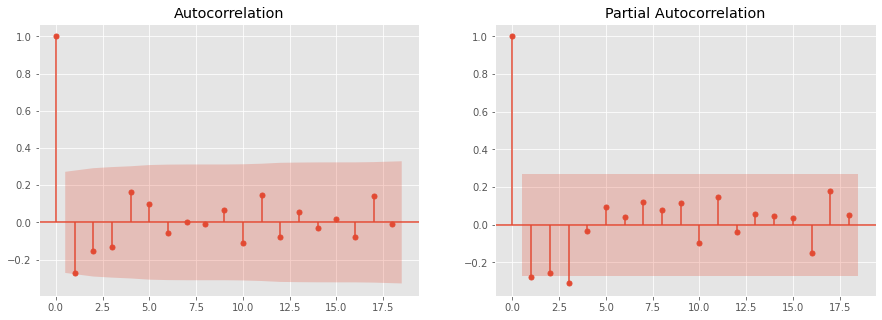

In [37]:
fig, ax = plt.subplots(1,2,figsize=(15,5))
plot_acf(series, ax=ax[0])
plot_pacf(series, ax=ax[1])
plt.show()


# Weekly: Train & Test Split

In [38]:
series=ds_weekly.Sales
split_time = 45
time=np.arange(len(ds_weekly))
xtrain=series[:split_time]
xtest=series[split_time:]
timeTrain = time[:split_time]
timeTest = time[split_time:]
print('Full Set Size ',series.shape)
print('Training Set Size ',xtrain.shape)
print('Testing Set Size ',xtest.shape)

Full Set Size  (53,)
Training Set Size  (45,)
Testing Set Size  (8,)


# Weekly: ARIMA Model

In [39]:
from statsmodels.tsa.arima.model import ARIMA
model = ARIMA(xtrain, order=(1,1,2))
model_fit = model.fit()
print(model_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Sales   No. Observations:                   45
Model:                 ARIMA(1, 1, 2)   Log Likelihood                -650.134
Date:                Wed, 11 May 2022   AIC                           1308.269
Time:                        06:56:54   BIC                           1315.405
Sample:                             0   HQIC                          1310.915
                                 - 45                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0320      0.594      0.054      0.957      -1.133       1.197
ma.L1         -0.5148      0.554     -0.930      0.353      -1.600       0.571
ma.L2         -0.3466      0.370     -0.937      0.3

In [40]:
ytrain_pred = model_fit.predict()
ytest_pred = model_fit.predict(start=min(timeTest),end=max(timeTest),dynamic=True)
print('MSE Train :',np.sqrt(np.mean((ytrain_pred - xtrain)**2)))
print('MSE Test :',np.sqrt(np.mean((ytest_pred - xtest)**2)))
forecast = model_fit.forecast(20, alpha=0.05)
plot_(t_train = timeTrain,t_test = timeTest,x_train = xtrain,x_test = xtest,x_train_pred = ytrain_pred
      ,x_test_pred = ytest_pred,forecast = forecast,title='Weekly')

MSE Train : 703351.5317623826
MSE Test : 1875993.8602853375


# WEEKLY: SARIMAX Model

In [41]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
s_model = SARIMAX(endog=xtrain , order=(1, 1, 2), seasonal_order=(1, 1, 1, 3), trend='c')
s_model_fit=s_model.fit()
print(s_model_fit.summary())

                                      SARIMAX Results                                      
Dep. Variable:                               Sales   No. Observations:                   45
Model:             SARIMAX(1, 1, 2)x(1, 1, [1], 3)   Log Likelihood                -609.274
Date:                             Wed, 11 May 2022   AIC                           1232.549
Time:                                     06:56:54   BIC                           1244.544
Sample:                                          0   HQIC                          1236.917
                                              - 45                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept   4.756e+04   7.89e+04      0.603      0.547   -1.07e+05    2.02e+05
ar.L1         -0.9680      

In [42]:
ytrain_pred = s_model_fit.predict()
ytest_pred = s_model_fit.predict(start=min(timeTest),end=max(timeTest),dynamic=True)
print('RMSE Train :',np.sqrt(np.mean((ytrain_pred - xtrain)**2)))
print('RMSE Test :',np.sqrt(np.mean((ytest_pred - xtest)**2)))
forecast = s_model_fit.forecast(20, alpha=0.05)
plot_(t_train = timeTrain,t_test = timeTest,x_train = xtrain,x_test = xtest,x_train_pred = ytrain_pred
      ,x_test_pred = ytest_pred,forecast = forecast,title='Weekly')

RMSE Train : 911211.8539207052
RMSE Test : 649322.667901029


# Daily: Trend

In [43]:
fig = go.Figure(data=[go.Scatter(x=ds_daily.Date,y=ds_daily.Sales)])
fig.update_layout(xaxis_title="Date",yaxis_title="Sales",title='Daily Trend',height=400,template='ggplot2')
fig.show()

# Daily: Test of Stationarity of Actual Series

In [44]:
print('\n***************************Daily*********************************')
output = adfuller(ds_daily.Sales)
print('ADF Statistic: {0:.2f} and P value:{1:.5f}'.format(*output))
print("As we can see the p value is extreemly high which indicates that we are fail to reject null hypothesis " \
      "and can conclude that series is not stationary ")


***************************Daily*********************************
ADF Statistic: 0.09 and P value:0.96521
As we can see the p value is extreemly high which indicates that we are fail to reject null hypothesis and can conclude that series is not stationary 


# Daily: Test of Stationarity with 1 differencing of series

In [45]:
print('\n***************************Daily*********************************')
series_date = ds_daily.Sales.diff(d)
series_date = series_date.dropna()
output = adfuller(series_date)
print('ADF Statistic: {0:.2f} and P value:{1:.5f}'.format(*output))
print("As we can see the p value is close to zero which is less than .05 hence we reject null hypothesis and conclude " \
      " that series is stationary with rolling mean difference at lag of 12 ")


***************************Daily*********************************
ADF Statistic: -6.35 and P value:0.00000
As we can see the p value is close to zero which is less than .05 hence we reject null hypothesis and conclude  that series is stationary with rolling mean difference at lag of 12 


# Daily: PACF & ACF

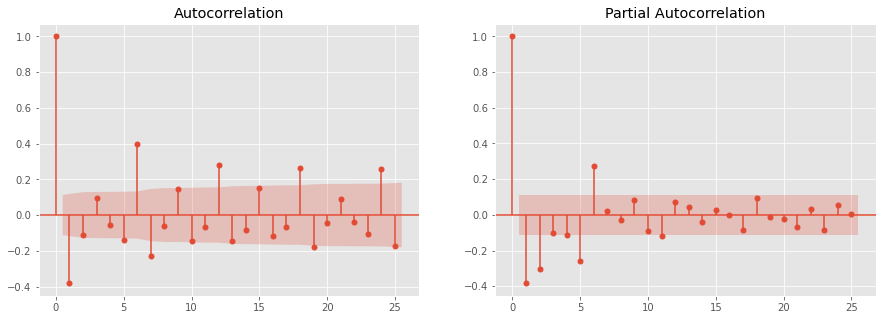

In [46]:

fig, ax = plt.subplots(1,2,figsize=(15,5))
plot_acf(series_date, ax=ax[0])
plot_pacf(series_date, ax=ax[1])
plt.show()


# Daily: Train & Test Split

In [47]:
series_date=ds_daily.Sales
split_time = 250
time_d=np.arange(len(ds_daily))
xtrain_d=series_date[:split_time]
xtest_d=series_date[split_time:]
timeTrain_d = time_d[:split_time]
timeTest_d = time_d[split_time:]
print('Full Set Size ',series_date.shape)
print('Training Set Size ',xtrain_d.shape)
print('Testing Set Size ',xtest_d.shape)

Full Set Size  (305,)
Training Set Size  (250,)
Testing Set Size  (55,)


# Daily: ARIMA Model

In [48]:
s_model = ARIMA(endog=xtrain_d , order=(1, 1, 1))
s_model_fit=s_model.fit()
print(s_model_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                  Sales   No. Observations:                  250
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -3375.415
Date:                Wed, 11 May 2022   AIC                           6756.829
Time:                        06:56:55   BIC                           6767.381
Sample:                             0   HQIC                          6761.077
                                - 250                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0714      0.097      0.734      0.463      -0.119       0.262
ma.L1         -0.9136      0.038    -23.876      0.000      -0.989      -0.839
sigma2       4.19e+10   6.23e-13   6.73e+22      0.0

In [49]:
ytrain_pred = s_model_fit.predict()
ytest_pred = s_model_fit.predict(start=min(timeTest_d),end=max(timeTest_d),dynamic=True)

print('MSE Train :',np.sqrt(np.mean((ytrain_pred - xtrain_d)**2)))
print('MSE Test :',np.sqrt(np.mean((ytest_pred - xtest_d)**2)))
forecast = s_model_fit.forecast(20, alpha=0.05)

plot_(t_train = timeTrain_d,t_test = timeTest_d,x_train = xtrain_d,x_test = xtest_d,x_train_pred = ytrain_pred
      ,x_test_pred = ytest_pred,forecast = forecast,title='Daily')

MSE Train : 189922.48151550323
MSE Test : 345504.02246283763


# Daily: SARIMAX Model

In [50]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
s_model = SARIMAX(endog=xtrain_d , order=(1, 1, 1), seasonal_order=(1, 1, 2, 12), trend='t')
s_model_fit=s_model.fit()
print(s_model_fit.summary())

                                        SARIMAX Results                                        
Dep. Variable:                                   Sales   No. Observations:                  250
Model:             SARIMAX(1, 1, 1)x(1, 1, [1, 2], 12)   Log Likelihood               -3220.406
Date:                                 Wed, 11 May 2022   AIC                           6454.812
Time:                                         06:56:58   BIC                           6479.088
Sample:                                              0   HQIC                          6464.597
                                                 - 250                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
drift          3.6714     12.873      0.285      0.775     -21.559      28

In [51]:
ytrain_pred = s_model_fit.predict()
ytest_pred = s_model_fit.predict(start=min(timeTest_d),end=max(timeTest_d),dynamic=True)

print('MSE Train :',np.sqrt(np.mean((ytrain_pred - xtrain_d)**2)))
print('MSE Test :',np.sqrt(np.mean((ytest_pred - xtest_d)**2)))
forecast = s_model_fit.forecast(30, alpha=0.05)
xt = max(timeTest_d)+np.arange(len(forecast))

plot_(t_train = timeTrain_d,t_test = timeTest_d,x_train = xtrain_d,x_test = xtest_d,x_train_pred = ytrain_pred
      ,x_test_pred = ytest_pred,forecast = forecast,title='Daily')

MSE Train : 199274.41918314228
MSE Test : 351461.0739462504


Linear regression model based on frequency and length of stay of customers (LRFM Segmentation) which will predict Sales generated by customers.

In [52]:
from sklearn.linear_model import LinearRegression
import scipy.stats as stats
from sklearn.model_selection import train_test_split
from statsmodels.stats.stattools import durbin_watson
import statsmodels.api as sm
from statsmodels.stats.diagnostic import linear_rainbow
from statsmodels.stats.api import het_goldfeldquandt
from sklearn.metrics import r2_score

## Split the data

In [53]:
xtrain1,xtest1,ytrain1,ytest1 = train_test_split(LRFM[['Frequency', 'Length_of_stay']],LRFM.Monetary
                                             ,test_size=.3,random_state=49,shuffle=True)
print(xtrain1.shape)
print(xtest1.shape)


(3037, 2)
(1302, 2)


# Log Log Model

Log-Log model performs better on the data which improves R square and following are all assumptions of regression. For all assumption --> Plots of residual vs predicted 

In [54]:
from sklearn.preprocessing import PolynomialFeatures

In [55]:
# poly = PolynomialFeatures(2)
# xtest = poly.fit_transform(xtest1)
# xtrain = poly.fit_transform(xtrain1)

inp_test=sm.add_constant(np.log1p(xtest1))
inp_train=sm.add_constant(np.log1p(xtrain1))
ytrain=np.log1p(ytrain1)
ytest=np.log1p(ytest1)
ols=sm.OLS(ytrain,inp_train)
model=ols.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:               Monetary   R-squared:                       0.652
Model:                            OLS   Adj. R-squared:                  0.652
Method:                 Least Squares   F-statistic:                     2840.
Date:                Wed, 11 May 2022   Prob (F-statistic):               0.00
Time:                        06:56:58   Log-Likelihood:                -3411.1
No. Observations:                3037   AIC:                             6828.
Df Residuals:                    3034   BIC:                             6846.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
const              7.0743      0.030    233.

C:\Users\akgabi\Anaconda3\lib\site-packages\statsmodels\tsa\tsatools.py:142: FutureWarning:

In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only



**Insights:**

*   If customers increase the frequency of purchase by 1 percent then we can expect that sales will increase by 1.3%
*   We can expect 0.05% Sales increase As Customers stay long with the business.



In [56]:
print('Below are the interprataion of all 2 coeficients')
print('if customers increase the frequency of purchase by 1 percent then we can expect that sales will increase by 1.3%')
print('As customers are staying long with business then we can expect that sales will increase by 0.05%')

Below are the interprataion of all 2 coeficients
if customers increase the frequency of purchase by 1 percent then we can expect that sales will increase by 1.3%
As customers are staying long with business then we can expect that sales will increase by 0.05%


# Get Error

In [57]:
ytrain_pred=model.predict(inp_train)
ytest_pred=model.predict(inp_test)

train_res=ytrain-ytrain_pred
test_res=ytest-ytest_pred

train_mse= np.mean(train_res**2)
test_mse= np.mean(test_res**2)

print('Train MSE:{0:.4f}'.format(train_mse))
print('Test MSE:{0:.4f}'.format(test_mse))


Train MSE:0.5535
Test MSE:0.6311


# Get R square

In [58]:
r2_train=r2_score(ytrain,ytrain_pred)
r2_test=r2_score(ytest,ytest_pred)
print('R square Train:{0:.4f}'.format(r2_train))
print('R square Test:{0:.4f}'.format(r2_test))

R square Train:0.6518
R square Test:0.6311


# Linearrainbow test

H0 : Part of the data is Linear

Ha : Independent features does not have linear relation with target feature

In [59]:
pval=linear_rainbow(res=model,frac=0.5)[1]
print('P value {0:.2f}'.format(pval))

P value 0.45


# Homoscadastic -- Uniform variance
H0 : model is Homoscadastic

Ha : model is Heteroskedastic

In [60]:
homoscad = het_goldfeldquandt(train_res,inp_train)[1]
print('P Value {0:.2f}'.format(homoscad))

P Value 0.01


# Plot between Actual and predicted to check relationship

In [61]:
fig = make_subplots(rows=1, cols=2,subplot_titles=['Train','Test'])
fig.add_trace(go.Scatter(x=ytrain,y=ytrain_pred, mode='markers'
                         ,marker=dict(size=4,colorscale='Viridis',opacity=0.8)),row=1, col=1)
fig.add_trace(go.Scatter(x=ytest,y=ytest_pred, mode='markers'
                         ,marker=dict(size=4,colorscale='Viridis',opacity=0.8)),row=1, col=2)
fig.update_xaxes(title_text="Actual", row=1, col=1)
fig.update_yaxes(title_text="Predicted", row=1, col=1)
fig.update_xaxes(title_text="Actual", row=1, col=2)
fig.update_yaxes(title_text="Predicted", row=1, col=2)
fig.update_layout(height=400, width=800,template='ggplot2')
fig.show()

# Assumptions of Regression

1. **Normality**
    
2. **Independence** 
3. **Homoscedasticity**
4. **Linearity**.



In [62]:
textstr = "<br>".join(("SKEW={:.2f}".format(train_res.skew())
                     ,'Linearity Test P value={:.2f}'.format(pval)
                    ,'Homoscadastic Test P value={:.2f}'.format(homoscad)
                    ,'Durbin Watson value = {:.2f}'.format(durbin_watson(train_res))
                    ,'Train MSE ={:.3f}'.format(train_mse)
                    ,'Test MSE ={:.3f}'.format(test_mse)
                    ,'R square Train ={:.3f}'.format(r2_train)
                    ,'R square Test ={:.3f}'.format(r2_test)))

fig= px.scatter(x=ytrain,y=train_res,marginal_y="histogram",
               marginal_x="histogram", trendline="ols")

fig.update_layout(title="Test of Assumptions",xaxis_title="Predicted",yaxis_title="Residual",
                            font=dict(family="Courier New, monospace",size=10,color="RebeccaPurple"))

fig.add_annotation(x=4,y=4,xref="x",yref="y",text=textstr,showarrow=False,font=dict(size=10)
                   ,align="left",ax=20,ay=-30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="snow",opacity=0.8)
fig.show()

END:

This Notebook is complimented by EDA dashboards and reports in powerbi and presentation for even more context.
